In [618]:
!pip install matplotlib
!pip install torchvision
!pip install pillow

In [619]:
%matplotlib inline


# Neural Style Transfer (NST) на PyTorch


## Введение

В ходе этого упражнения мы воплотим алгоритм [Neural-Style algorithm](https://arxiv.org/abs/1508.06576), разработанный Leon A. Gatys, Alexander S. Ecker и Matthias Bethge.

Neural-Style или Neural-Transfer позволяет преобразовать изображение, применив к нему стиль с другого изображения. Всего алгоритму нужно три изображения: "отправное", "контент" и "стиль". В ходе работы алгоритм видоизменяет отправное изображение таким образом, чтобы его содержимое было похоже на то, что изображено на изображении "контент", но графический стиль изображения был бы похож на стиль последнего изображения в связке.

# Домашнее задание

- [ ] Установите размер изображения равным 512
- [ ] Замените нейросеть на VGG-16
- [ ] Поменяйте вес вклада стиля и контента, в общую лосс-функцию (например, на 1000 к 1)
- [ ] Сгенерируйте собственное NST изображение для выбранных вами входных, контент- и стилевых изображений

## Как работает этот метод

[Real-Time Video Abstraction](https://cs.colby.edu/courses/S19/cs365/papers/winnemoller-videoAbstraction-SIG06.pdf), Winnemoller, 2006

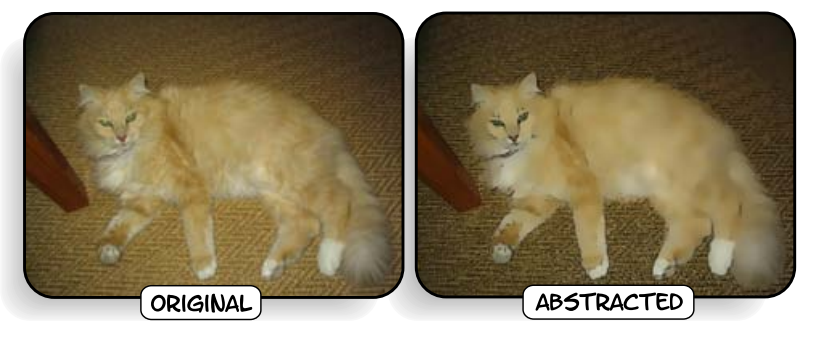

[Painterly rendering with curved brush strokes of multiple sizes](https://dl.acm.org/doi/10.1145/280814.280951), Hertzmann 1998

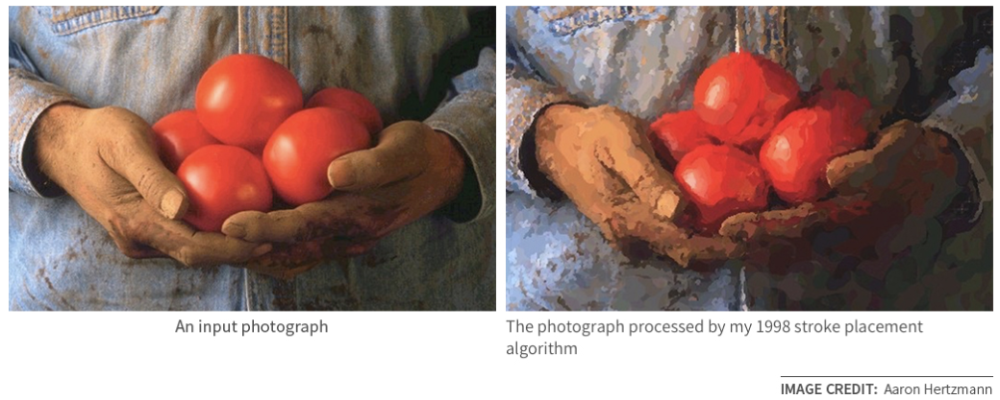

[Image analogies](https://dl.acm.org/doi/10.1145/383259.383295), Hertzmann 2001

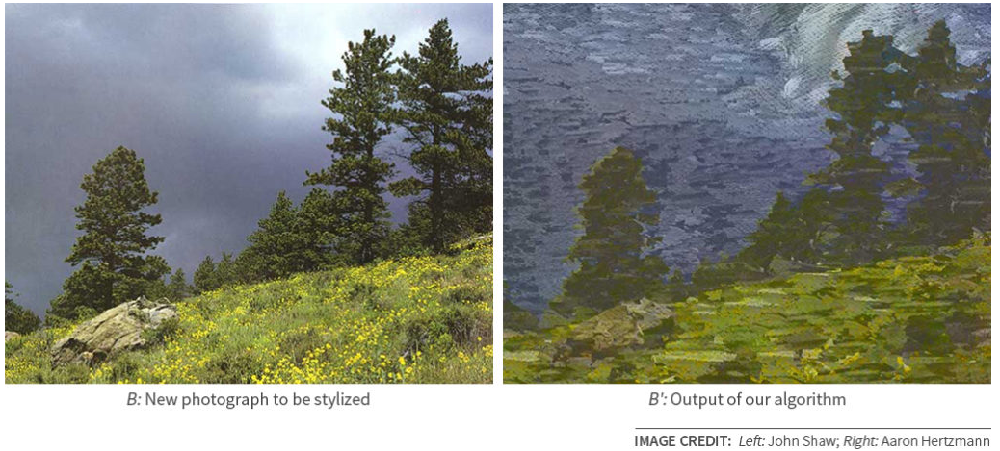

[A Neural Algorithm of Artistic Style](https://arxiv.org/pdf/1508.06576.pdf), Gatys 2016

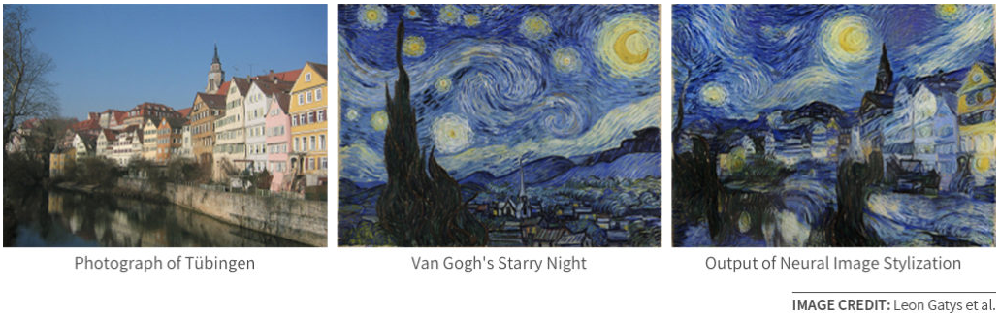

### История переноса стиля

* 1990е – методы на основе фильтрации и обработки сигналов
* 2000е – множество техник, например image pairs, image analogies
* 2015+ – нейронный перенос стиля

### Основные технологии: Нейросеть VGG

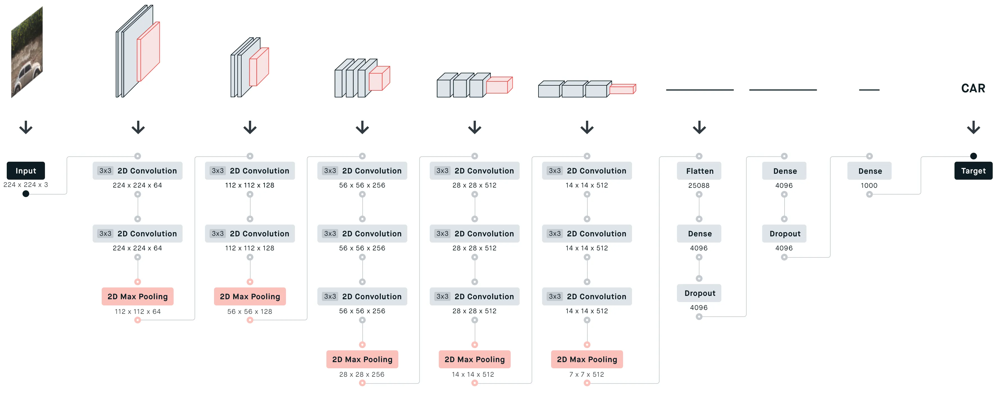

[VGG-Net Architecture Explained](https://medium.com/@siddheshb008/vgg-net-architecture-explained-71179310050f)

Появилась в 2014, была использована в статье Gatys 2016 и осталась в каждом учебном примере. По сути, углубление сети AlexNet которая появилась в 2012.

Проиграла GoogLeNet в задаче классификации, но победила в задаче локализации изображений.

Очень долго обучается из-за затухающих градиентов.

### Идея 1: DeepDream

В 2016 в Google появилась идея оптимизировать не веса нейросети (она уже обучена), а входное изображение **с целью усилить интенсивность какого-нибудь компонента эмбеддинга** (конкретной карты признаков, feature map). Постоянно появлялись глаза и носы, наверное потому что в ImageNet так много классов животных.

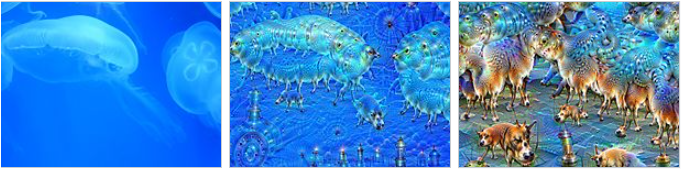

### Идея №2: Синтез текстур через CNN

[Texture Synthesis Using Convolutional Neural Networks](https://arxiv.org/abs/1505.07376)

Идея восстановления исходного изображения по эмбеддингам конкретного уровня. Получаются текстуры разной степени детализации.

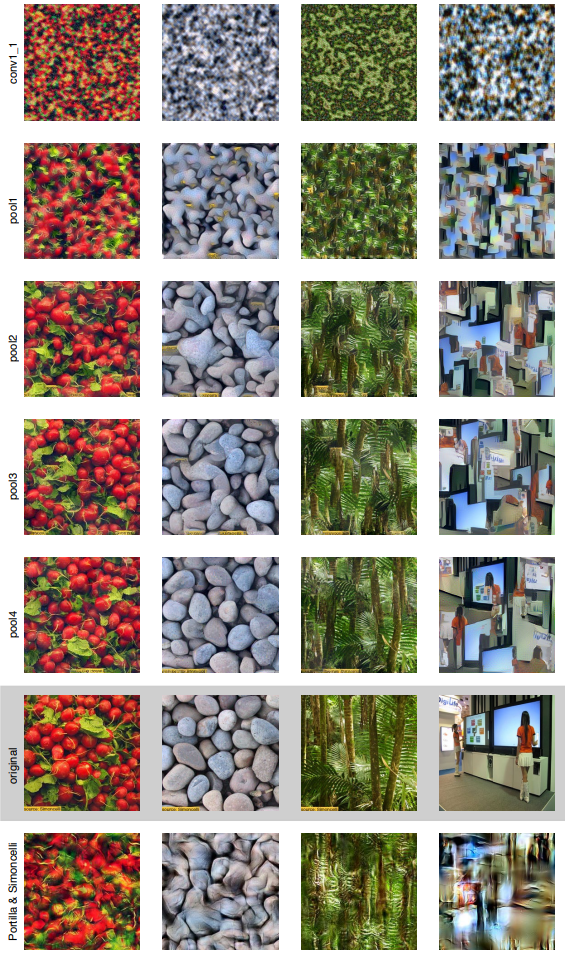

## Математическая база

Мы будем воссоздавать метод [A Neural Algorithm of Artistic Style](https://arxiv.org/pdf/1508.06576.pdf), Gatys 2016

Поскольку нам теперь доступны латентные представления изображений, мы будем пользоваться всеми картами признаков, которые нам доступны внутри VGG. На каждом слое находится видоизмененное входное изображение, эти карты и создают признаковое описание входного объекта.

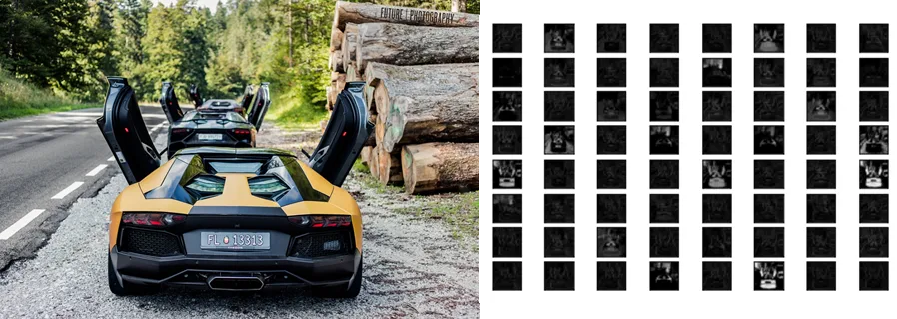

Близость эмбеддингов для нас будет означать близость семантической (_контентной_) информации. Мы просто можем отобрать какой-нибудь слой _l_ и определять близость двух признаковых карт F и P по формуле СКО:

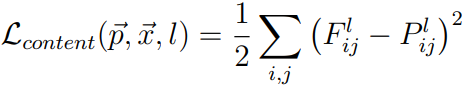

p – исходное изображение, P – его признаки, x – сгенерированное изображение (его признаки – F).

Как отразить стиль изображения? Все эмбеддинги все-таки характеризуют локализованную информацию, а стиль должен быть глобальной характеристикой. Каждая "карта признаков" получена после преобразования объекта вдоль определенного пути в нейросети, прохода его через несколько жестко заданных фильтров. Выход – найти корреляцию всего множества разных признаковых карт на одном заданном уровне нейросети (а лучше, на нескольких). Получатся матрицы Грама.

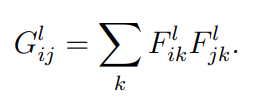

Например, получим признаки с уровня **112 x 112** (первый из двух, там у нас изображение перестает быть глубиной 3 (RGB) и получает глубину в 128 (признаков). Можно сказать, что на уровне conv_2_1, входная картинка становится `128-ю картинками размером 112 на 112`.

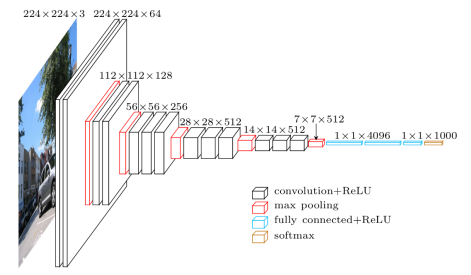

А мы посчитаем сходство между каждой из этих 128 картинок через скалярное произведение. И поймем, насколько коррелируют признаки этого изображения, насколько активировались разные пути прохождения информации в нейросети.

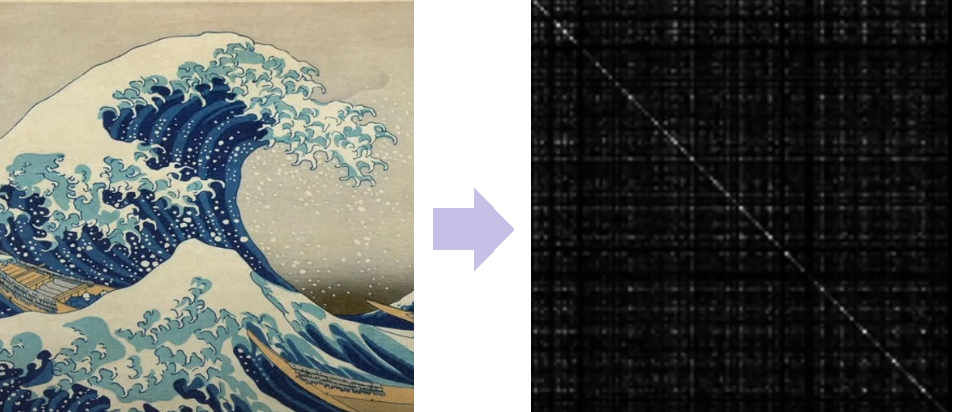

Чтобы что-то оптимизировать, нужно что-то минимизировать. Для одной и той же нейросети, матрица Грама некоторого слоя показывает взаимный характер срабатывания разных признаков, и минимизацию этих матриц мы будем считать критерием схожести стилей.

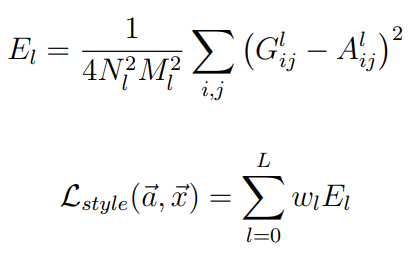

Общий критерий оптимизации (лосс-функция) будет сочетать, в заданной пропорции, критерий удаленности по контенту и по стилю.

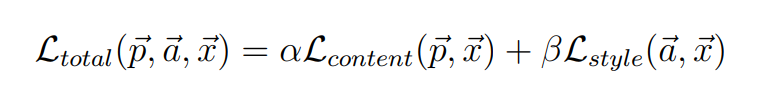

Например, в пропорции 1 к 10, или 1 к 1000... Или наоборот.

### Что можно совершенствовать?

* Подбирать пропорцию контент-стиль
* Добавить total variation loss, который позволит оптимизировать по _разнице интенсивности между соседними пикселями_, чтобы получать более гладкое изображение
* Мы будем оптимизировать "отправное" изображение, а не нейросеть. В качестве отправного можно брать разные изображения, но лучше всего брать "контентное"
* Ускорять... Instance Normalization от [Johnson&Ulyanov 2016](https://arxiv.org/pdf/1607.08022.pdf)
* [Conditional Instance Normalization](https://paperswithcode.com/method/conditional-instance-normalization) чтобы создавать сразу 32+ изображения с разным стилем
* Или уже переходить на модели с декодером, на GAN и дальше – это совсем другие методы

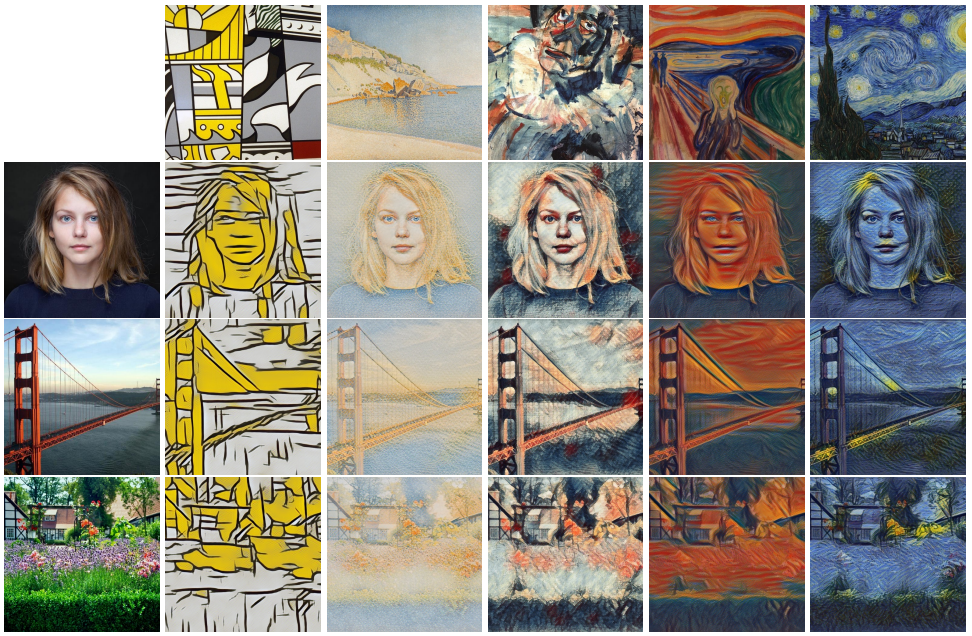

## Шаблонный код, загружаем нейросеть и выбираем вычислитель

Какие библиотеки нам понадобятся:

-  ``torch``, ``torch.nn``, ``numpy`` (необходимы для работы с нейросетями через PyTorch)
-  ``torch.optim`` (хорошие процедуры оптимизации)
-  ``PIL``, ``PIL.Image``, ``matplotlib.pyplot`` (загрузка и отображение картинок)
-  ``torchvision.transforms`` (чтобы автоматизировать преобразование изображений)
-  ``torchvision.models`` (здесь у нас предобученные модели)
-  ``copy`` (системная библиотека чтобы создавать копии объектов, а то python не любит двойную работу...)

In [620]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import io
from PIL import Image
import matplotlib.pyplot as plt

import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights, vgg16, VGG16_Weights

import copy

Дальше, нужно указать, на каком вычислительном устройстве будет выполняться нейросеть и вся процедура оптимизации. Если вы выберете больший размер изображений, процедуре потребуется больше времени.

Функция ``torch.cuda.is_available()`` позволяет узнать, есть ли в системе графическая карта (GPU). Затем мы при помощи ``torch.device`` укажем, на каком устройстве будут производиться вычисления по умолчанию, и будем пользоваться командой ``.to(device)`` чтобы переносить модули нейросети или матрицы (тензоры) в память нужного устройства.

In [621]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.set_default_device(device)

In [622]:
device

device(type='cpu')

## Загружаем изображения

Здесь мы загрузим Стиль и Контент (два изображения). При загрузке через библиотеку PIL, значение каждого пикселя находится  в диапазоне между 0 и 255. Потом мы переведем значения в диапазон от 0 до 1, масштабируем изображения до одного размера, заодно обрежем их до квадрата.

Если подать на вход нейросети матрицу с значениями от 0 до 255, нейросеть тоже обработает эту информацию, но эмбеддинги не будут отражать то, чему нейросеть смогла научиться на исходном датасете. Скорее всего, сеть не распознает содержимое и стиль так, как мы ожидаем.

В одной из версий демонстрации мы используем следующие изображения:
[picasso.jpg](https://pytorch.org/tutorials/_static/img/neural-style/picasso.jpg) и
[dancing.jpg](https://pytorch.org/tutorials/_static/img/neural-style/dancing.jpg), но вы можете взять любые две картинки, например [что-нибудь абстрактное](https://unsplash.com/s/photos/abstract) из **unsplash**. Их нужно разместить в папке ``data/images`` в текущей директории (если вы работаете в Colab, по умолчанию это – директория ``content``).



In [623]:
# https://stackoverflow.com/questions/43512615/reshaping-rectangular-image-to-square
def resize_image(image: Image, length: int) -> Image:
    """
    Resize an image to a square. Can make an image bigger to make it fit or smaller if it doesn't fit. It also crops
    part of the image.

    :param self:
    :param image: Image to resize.
    :param length: Width and height of the output image.
    :return: Return the resized image.
    """

    """
    Resizing strategy : 
     1) We resize the smallest side to the desired dimension (e.g. 1080)
     2) We crop the other side so as to make it fit with the same length as the smallest side (e.g. 1080)
    """
    if image.size[0] < image.size[1]:
        # The image is in portrait mode. Height is bigger than width.

        # This makes the width fit the LENGTH in pixels while conserving the ration.
        resized_image = image.resize((length, int(image.size[1] * (length / image.size[0]))))

        # Amount of pixel to lose in total on the height of the image.
        required_loss = (resized_image.size[1] - length)

        # Crop the height of the image so as to keep the center part.
        resized_image = resized_image.crop(
            box=(0, required_loss / 2, length, resized_image.size[1] - required_loss / 2))

        # We now have a length*length pixels image.
        return resized_image
    else:
        # This image is in landscape mode or already squared. The width is bigger than the heihgt.

        # This makes the height fit the LENGTH in pixels while conserving the ration.
        resized_image = image.resize((int(image.size[0] * (length / image.size[1])), length))

        # Amount of pixel to lose in total on the width of the image.
        required_loss = resized_image.size[0] - length

        # Crop the width of the image so as to keep 1080 pixels of the center part.
        resized_image = resized_image.crop(
            box=(required_loss / 2, 0, resized_image.size[0] - required_loss / 2, length))

        # We now have a length*length pixels image.
        return resized_image

In [624]:
# Какого размера изображения мы хотим обрабатывать
width_height = 512

imsize = width_height if torch.cuda.is_available() else width_height  # Если нет GPU, делаем изображение поменьше

loader = transforms.Compose([
    transforms.Resize(imsize),  # масштабируем с сохранением соотношения сторон
    transforms.CenterCrop(imsize), # обрежем края чтобы получить квадратное изображение
    transforms.ToTensor()])  # преобразуем в нужный нам класс – Torch Tensor



def image_loader(image_name):
    # Загрузим и преобразуем картинку, вдруг она в оттенках серого или с альфа-каналом...
    image = Image.open(image_name).convert('RGB')

    # width, height = image.size
    # if width > height:
    #     width = height
    # elif height > width:
    #     height = width
    
    image = resize_image(image, width_height)

    
    # нейросеть ждет не просто картинку, а набор картинок
    # поэтому мы добавим к изображению одно мнимое измерение
    # (количество картинок в батче всегда будет равно 1)
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)

# https://stackoverflow.com/questions/19981429/get-image-name-of-impaths-in-python
import os

path_style_img = "./data/images/dog_and_drone.png"
path_content_img = "./data/images/griphon.png"
path_steps_img = "./data/steps"
path_result_img = "./data/result"

name_style_img = os.path.basename(path_style_img)
name_content_img = os.path.basename(path_content_img)

style_img = image_loader(path_style_img)
content_img = image_loader(path_content_img)

assert style_img.size() == content_img.size(), \
    "Изображения должны быть одинакового размера, что-то пропущено в процедуре подготовки изображений"

Теперь создаем функцию, которая преобразует рабочую копию изображения обратно в PIL формат и отображает картинку при помощи ``plt.imshow``. И сразу используем ее чтобы вывести изображения – Стиль и Контент.

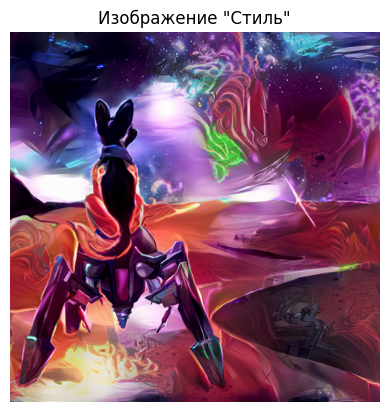

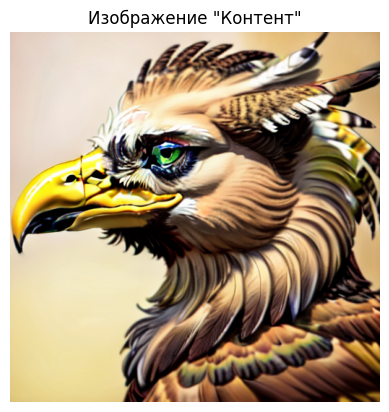

In [625]:
unloader = transforms.ToPILImage()  # Преобразуем в картинку PIL

plt.ion()

def imshow(tensor, title=None):
    image = tensor.cpu().clone()  # создаем копию тензора чтобы не менять исходный
    image = image.squeeze(0)      # устраняем лишнее измерение (которое делало батч из изображения)
    image = unloader(image)
    plt.imshow(image)
    
    if title is not None:
        plt.title(title)
    plt.pause(0.001) # Дадим графику обновиться

plt.figure()
plt.axis('off');
imshow(style_img, title='Изображение "Стиль"')

plt.figure()
plt.axis('off');
imshow(content_img, title='Изображение "Контент"')

## Критерии оптимизации (лосс-функции)

### Расхождение по контенту (Content loss)

Итак, нам нужно реализовать функцию, которая измеряет расстояние между двумя изображениями в части содержимого изображений. На входе будет отдельный слой, для которого мы хотим посчитать лосс – набор карт признаков $F_{XL}$ слоя $L$. Нейросеть будет обрабатывать входной объект $X$ и возвращать косинусное расстояние $w_{CL}.D_C^L(X,C)$ (косинусный коэффициент, коэффициент Отиаи...) между входной картинкой $X$ и картинкой $C$, из которой мы берем контент. карты признаков целевого изображения по контенту ($F_{CL}$) тоже нужно будет передать в функцию.

Это простое скалярное произведение ($\sum_{i=1}^{n}{A_i B_i}$) разделенное на произведение мер всех сравниваемых объектов ($\sqrt{\sum_{i=1}^{n}{A_i^2}} \cdot \sqrt{\sum_{i=1}^{n}{B_i^2}}$).

Рассчитывать эту метрику будет объект типа Torch Module, его конструктор принимает на вход $F_{CL}$. Расстояние $\|F_{XL} - F_{CL}\|^2$ – это среднеквадратическое отклонение между наборами карт признаков, которое мы рассчитаем при помощи ``nn.MSELoss``.

Этот модуль встает сразу после какого-нибудь из слоев нейросети, по которому мы будем считать расхождение по контенту. Каждый раз когда нейросеть получит на вход новое изображение (его новую итерацию), на нужных нам слоях произведутся вычисления нужных нам метрик, а благодаря автоматическому дифференцированию, мы заодно получим и градиент ошибки. Чтобы слой не только считал метрику, но и передавал информацию дальше по нейросети, нужно определить метод ``forward``, который будет считать расстояние, а затем просто передавать входной набор признаков – на выход. Метрику мы получим как один из доступных параметров модуля.

In [626]:
class ContentLoss(nn.Module):

    def __init__(self, target,):
        super(ContentLoss, self).__init__()
        # нуно "отвязать" (detach) набор целевых признаков (target content)
        # от других объектов, которые находят его градиент. Это статический объект
        # Если этого не сделать, метод forward вернут нам ошибку
        self.target = target.detach()
    
    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input
    

Хотя модуль и называется ``ContentLoss``, он на самом деле не является настоящей лосс-функцией по всем правилам PyTorch. Ему не хватает функции  ``backward``, чтобы подсказать PyTorch, как производить автоматическое дифференцирование. Но мы не будем обучать эту нейросеть и ``backward`` не понадобится.

### Расхождение по стилю (Style Loss)

Модуль расчета близости по стилю реализован схожим образом с модулем, который рассчитывает близость по контенту.

Это прозрачный слой внутри нейросети, который находит лосс-функцию по стилю между входным изображением и шаблоном. Сперва нужно рассчитать матрицу Грама $G_{XL}$. Сама матрица Грама получается перемножением матрицы на ее транспонированный вариант. Конкретно в нашем случае, входной матрицей будет являться матрица карт $F_{XL}$ на слое $L$.

Мы изменим размерность $F_{XL}$ так, чтобы преобразованная матрица $\hat{F}_{XL}$ имела размерность $K$\ x\ $N$, где $K$ – количество признаковых описаний на слое $L$, а $N$ – длина отдельно взятой матрицы $F_{XL}^k$, если ее растянуть в вектор. 

Например, первая линия полученной матрицы $\hat{F}_{XL}$ – это вытянутая в один вектор первая по счету карта признаков $F_{XL}^1$.

В конце концов нужно будет нормализовать матрицу Грама, что мы сделаем, разделив ее значения на суммарное количество элементов. Это позволит нам обойти ту проблему, при которой признаковые матрицы $\hat{F}_{XL}$ на более ранних слоях, где они еще сохраняют большой размер (высокое значение $N$) будут иметь большие значения матрицы Грама. В свою очередь, этот дисбаланс (более крупные значения у входных слоев) приведет к тому, что более ранние слои (до пулингов, которые уменьшают размер признаковых описаний) будут сильнее влиять на решение из-за того, что их показатели сильнее скажутся на градиенте ошибки.

Информация о стиле изображения в большей степени находится в средних и последних слоях нейросети, поэтому без этой нормализации перенос стиля не сработает.

In [627]:
def gram_matrix(input):
    a, b, c, d = input.size()
    # a=размер батча(=1)
    # b=количество карт признаков, для которых мы считаем матрицу
    # (c,d)=размерность карты признаков f (N=c*d)
    
    features = input.view(a * b, c * d)  # изменим размерность матрицы F_XL, получим \hat F_XL
    
    G = torch.mm(features, features.t())  # рассчитать произведение матриц чтобы получить матрицу Грама
    
    # нормализуем значения матрицы Грама, разделив значения матрицы на количество элементов
    return G.div(a * b * c * d)

Модуль для расчета расстояния по стилю между двумя изображениями очень похож на уже реализованный модуль для расчета расстояния по содержимому. Расстояние по стилю рассчитывается как СКО между $G_{XL}$ и $G_{SL}$.

In [628]:
class StyleLoss(nn.Module):

    def __init__(self, target_feature):
        super(StyleLoss, self).__init__()
        self.target = gram_matrix(target_feature).detach()

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = F.mse_loss(G, self.target)
        return input

## Загружаем модель

Укажем, откуда взять предобученную нейросеть. Как и в исходной статье, мы будем использовать VGG с 19 слоями.

Специально в PyTorch, нейросеть VGG реализована при помощи двух отдельных модулей, упакованных в объект ``Sequential``: первый модуль ``features`` (производит обработку изображений, в нем слои свертки и пулинга), второй – ``classifier`` (занимается задачей классификации, в нем содержатся полносвязанные слои).

Нам понадобится только первый модуль – ``features``, по его выводам мы будем оценивать близость изображений по стилю и по контенту. В нейросети есть слои, которые ведут себя по-разному в зависимости от того, находится ли сеть в состоянии обучения, или нет. Очевидно, нам нужно чтобы сеть не дообучалась, поэтому мы переведем ее в состояние исполнения при помощи ``.eval()`` (можно сказать, нам нужен _только инференс_).

In [629]:
# cnn = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
cnn = vgg16(weights=VGG16_Weights.DEFAULT).features.eval()

Как и другие сети, VGG лучше работает с нормализованными изображениями. Параметры нормализации исходного датасета – mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225] (мат.ожидание и дисперсия). Поэтому перед отправкой в сеть мы нормализуем наши изображения при помощи этих статистических параметров.

In [630]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406])
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225])

# упаковочный класс, чтобы картинку было легче передать в объект ``nn.Sequential``
class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        # преобразуем мат.ожидание и дисперсию при помощи .view так, чтобы
        # их можно было легко умножить на тензор с картинкой
        # Картинка имеет размерность [B x C x H x W]
        # Мы приводим коэффициенты нормализации к размерности [C x 1 x 1] 
        # B – размер батча. C – количество каналов. H – высота, W – ширина изображения.
        self.mean = torch.tensor(mean).view(-1, 1, 1)
        self.std = torch.tensor(std).view(-1, 1, 1)

    def forward(self, img):
        # нормализуем изображение ``img``
        return (img - self.mean) / self.std

Объект ``Sequential`` обычно служит для объявления нейросети, слой за слоем, или другого набора вложенных модулей.

К примеру, ``vgg19.features`` тоже содержит набор вложенных модулей (``Conv2d``, ``ReLU``, ``MaxPool2d``, ``Conv2d``, ``ReLU``…) в нужном порядке. Измерять расхождение по стилю и содержимому мы будем сразу после некоторых из сверточных слоев ``Conv2d``.

Для этого мы фактически создаем новую нейросеть, в которой в большой объекте ``Sequential`` будут содержаться все слои для вычисления расхождений.

Кстати, ниже мы определяем свою конвенцию для именования слоев (изначально у слоев модели нет имен).

In [631]:
# названия слоев, где мы будем рассчитывать расхождение по контенту
content_layers_default = ['conv_4']

# названия слоев, где мы будем рассчитывать расхождение по стилю
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

def get_style_model_and_losses(cnn, normalization_mean, normalization_std,
                               style_img, content_img,
                               content_layers=content_layers_default,
                               style_layers=style_layers_default):
    # модуль чтобы нормализоавть изображения
    normalization = Normalization(normalization_mean, normalization_std)

    # будем складывать меры расхождения (лоссы) в удобные массивы
    content_losses = []
    style_losses = []

    # поскольку ``cnn`` является объектом типа ``nn.Sequential``,
    # создадим новый ``nn.Sequential`` куда мы по порядку положим
    # все модули, которые будут проводить вычисления в нейросети
    model = nn.Sequential(normalization)

    i = 0  # пройдемся по элементам в исходной нейросети и дадим им имена
    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            # Чуть изменим параметры слоев активации (версия которая использована
            # в исходной нейросети не работает с нашей реализацией ``ContentLoss`` и ``StyleLoss``)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        # Добавим очередной модуль в нашу Sequential-модель
        model.add_module(name, layer)

        if name in content_layers:
            # если к последнему слою нужно пристыковать контент-лосс, сделаем это
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers:
            # а если имя слоя в списке стиль-лоссов, добавим после него соответствующий лосс
            target_feature = model(style_img).detach()
            style_loss = StyleLoss(target_feature)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    # все слои которые идут после последнего добавленного контент-лосса или стиль-лосса
    # нам будут не нужны, их можно отбросить
    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

Что мы будем использовать в качестве отправного изображения? Например, изображение **Контент** или **белый шум**.

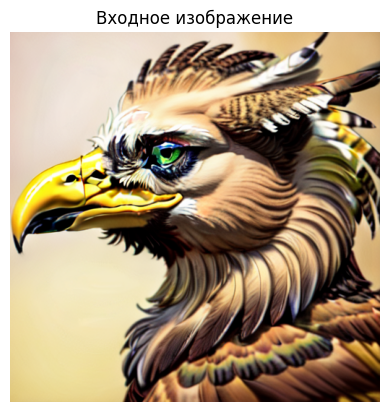

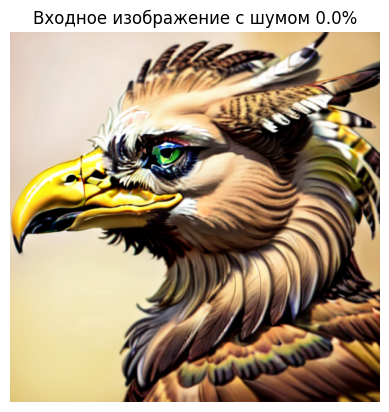

In [632]:
# Чтобы использовать исходную картинку, раскомментируйте:
input_img = content_img.clone()

plt.figure()
plt.axis('off');
imshow(input_img, title='Входное изображение')

# https://discuss.pytorch.org/t/how-to-add-noise-to-image-in-denoising-autoencoders/87755
noise_img = 0.0
def add_noise(inputs):
    global noise_img
    noise = torch.randn_like(inputs)*float(noise_img)
    return inputs + noise

input_img = add_noise(input_img)

# Чтобы использовать шум
#input_img = torch.randn(content_img.data.size())

# add the original input image to the figure:
plt.figure()
plt.axis('off');
imshow(input_img, title=f'Входное изображение с шумом {round(noise_img,2)*100}%')

## Оптимизация (градиентный спуск)

Как [предлагал](https://discuss.pytorch.org/t/pytorch-tutorial-for-neural-transfert-of-artistic-style/336/20?u=alexis-jacq) _Leon Gatys_, автор алгоритма, который мы реализуем, для оптимизации лучше использовать [L-BFGS](https://ru.wikipedia.org/wiki/%D0%90%D0%BB%D0%B3%D0%BE%D1%80%D0%B8%D1%82%D0%BC_%D0%91%D1%80%D0%BE%D0%B9%D0%B4%D0%B5%D0%BD%D0%B0_%E2%80%94_%D0%A4%D0%BB%D0%B5%D1%82%D1%87%D0%B5%D1%80%D0%B0_%E2%80%94_%D0%93%D0%BE%D0%BB%D1%8C%D0%B4%D1%84%D0%B0%D1%80%D0%B1%D0%B0_%E2%80%94_%D0%A8%D0%B0%D0%BD%D0%BD%D0%BE). В обучении нейросетей очень часто используется алгоритм `Adam`, и в этой задаче он будет требовать меньше ресурсов, но работать будет немного хуже. Остальные алгоритмы решают эту задачу слишком долго или нестабильно ([ссылка](https://blog.slavv.com/picking-an-optimizer-for-style-transfer-86e7b8cba84b)).

Так что создадим объект-оптимизатор L-BFGS при помощи команды PyTorch ``optim.LBFGS`` и привяжем его к объекту, в котором лежит наше изображение. Оптимизатор будет сдвигать параметры изображения (яркость каждого пикселя по каждому каналу) пока целевая функция будет падать.

In [633]:
def get_input_optimizer(input_img):
    optimizer = optim.LBFGS([input_img])
    return optimizer

Теперь, сердце алгоритма. Мы будем прогонять через нейросеть рабочую версию входного изображения, с каждой итерацией находя значение целевой функции. Затем при помощи фунции ``backward`` будем находить их градиенты (как они поменялись с прошлой итерации?). Оптимизатору нужна функция “closure” которая рассчитывает лосс, каждый раз на новой версии изображения.

Одно последнее ограничение алгоритма. Поскольку сеть оптимизирует численные параметры, мы вполне можем получить числа за пределом диапазона от 0 до 1. Поэтому после обновления рабочего изображения, мы скорректируем все его параметры, обрезав их значения до диапазона от 0 до 1, и так на каждой итерации.

In [634]:
# https://www.tutorialspoint.com/how-to-convert-a-torch-tensor-to-pil-image
# https://stackoverflow.com/questions/19981429/get-image-name-of-impaths-in-python
# https://stackoverflow.com/questions/73270890/how-do-i-convert-a-torch-tensor-to-an-image-to-be-returned-by-fastapi
# https://imagekit.io/blog/image-resizing-in-python/
# https://pytorch.org/vision/main/generated/torchvision.transforms.functional.to_pil_image.html
# https://pytorch.org/vision/main/generated/torchvision.transforms.ToPILImage.html#torchvision.transforms.ToPILImage
def some_unimportant_function(tensor):
    # tensor = torch.tensor# read the tensor from disk or whatever
    # image = transforms.ToPILImage()
    # return_image = io.BytesIO()
    
    # # https://qna.habr.com/q/1277088
    # # https://stackoverflow.com/questions/31077366/pil-cannot-identify-image-file-for-io-bytesio-object
    # return_image.seek(0)
    # return_image = return_image.read()
    
    # # image.save(return_image, "JPEG")
    # # return StreamingResponse(content=return_image, media_type="image/jpeg")


    # https://www.geeksforgeeks.org/converting-an-image-to-a-torch-tensor-in-python/
    # https://www.tutorialspoint.com/how-to-convert-a-torch-tensor-to-pil-image
    
    # https://discuss.pytorch.org/t/valueerror-pic-should-be-2-3-dimensional-got-4-dimensions/72680/7
    
    
    image=torch.squeeze(tensor)
    image=transforms.ToPILImage()(image)
    
    return image

In [635]:
def run_style_transfer(cnn, normalization_mean, normalization_std,
                       content_img, style_img, input_img, num_steps=300,
                       style_weight=10000, content_weight=100):
    global number_out_str
    print('Построение модели переноса стиля..')
    model, style_losses, content_losses = get_style_model_and_losses(cnn,
        normalization_mean, normalization_std, style_img, content_img)

    # Укажем, какой объект мы будем оптимизировать (включить параметр requires_grad fields)
    input_img.requires_grad_(True)
    # Переключим модель в режим исполнения, чтобы заморозить слои вроде dropout или батч нормализации normalization layers 
    model.eval()
    # Очевидно, мы не будем оптимизировать модель, так что заморозим все параметры
    model.requires_grad_(False)
    
    optimizer = get_input_optimizer(input_img)
    
    print('Оптимизируем картинку..')
    run = [0]
    while run[0] <= num_steps:

        def closure():
            # скорректируем значения входного изображения
            with torch.no_grad():
                input_img.clamp_(0, 1)

            optimizer.zero_grad() # обнуляем градиенты (иногда их используют между итерациями, но не сейчас)
            model(input_img) # знакомая вам функция, отправить картинку в модель

            # Посчитаем расхождение изображений по стилю и содержимому
            style_score = 0
            content_score = 0

            for sl in style_losses: style_score += sl.loss
            for cl in content_losses: content_score += cl.loss

            style_score *= style_weight # Домножаем каждую компоненту лосса на заданный вес
            content_score *= content_weight

            loss = style_score + content_score
            # И по этому значению осуществляем обратное распространение ошибки (обратно по сети, вплоть до изображения)
            loss.backward()

            run[0] += 1
            if run[0] % 50 == 0:
                print("run {}:".format(run))
                print('Style Loss : {:4f} Content Loss: {:4f}'.format(
                    style_score.item(), content_score.item()))
                
                plt.figure()
                plt.axis('off')
                imshow(input_img, title=f'Шаг {run[0]}')

                # https://www.tutorialspoint.com/how-to-convert-a-torch-tensor-to-pil-image
                # https://stackoverflow.com/questions/65903231/how-to-return-a-numpy-array-as-an-image-using-fastapi/71643439#71643439
                # https://stackoverflow.com/questions/71595635/render-numpy-array-in-fastapi/71639658#71639658
                
                # print(type(input_img))
                # print(type(some_unimportant_function(input_img)))

                # Сохраняем изображение через N шагом
                
                some_unimportant_function(input_img).save(fr"{path_steps_img}/({name_content_img.split('.')[0]})_to_({name_style_img.split('.')[0]})_step{number_out_str}_{run[0]}.{name_content_img.split('.')[-1]}") 
                
                print()

            return style_score + content_score

        optimizer.step(closure)

    # и в последний раз вернем изображение в диапазон
    with torch.no_grad():
        input_img.clamp_(0, 1)

    return input_img

Наконец, нам есть что запустить

In [636]:
# output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
#                             content_img, style_img, input_img, num_steps=300,
#                        style_weight=1000000, content_weight=100)

# plt.figure()
# plt.axis('off');
# imshow(output, title='Полученное изображение')

# # sphinx_gallery_thumbnail_number = 4
# plt.ioff()
# plt.show()


# output = some_unimportant_function(output)
# output.save(fr"{path_result_img}/({name_content_img.split('.')[0]})_to_({name_style_img.split('.')[0]})_result.{name_content_img.split('.')[-1]}")



In [637]:
import os

def begin_init_images():
    global path_style_img, path_content_img, style_img, content_img, name_style_img, name_content_img
    name_style_img = os.path.basename(path_style_img)
    name_content_img = os.path.basename(path_content_img)
    
    style_img = image_loader(path_style_img)
    content_img = image_loader(path_content_img)
    
    assert style_img.size() == content_img.size(), \
        "Изображения должны быть одинакового размера, что-то пропущено в процедуре подготовки изображений"

def whloader():
    global width_height
    # Какого размера изображения мы хотим обрабатывать
    # width_height = 512
    
    imsize = width_height if torch.cuda.is_available() else width_height  # Если нет GPU, делаем изображение поменьше
    
    loader = transforms.Compose([
        transforms.Resize(imsize),  # масштабируем с сохранением соотношения сторон
        transforms.CenterCrop(imsize), # обрежем края чтобы получить квадратное изображение
        transforms.ToTensor()])  # преобразуем в нужный нам класс – Torch Tensor

def run_unloader_and_show():
    unloader = transforms.ToPILImage()  # Преобразуем в картинку PIL
    
    plt.ion()
    
    plt.figure()
    plt.axis('off');
    imshow(style_img, title='Изображение "Стиль"')
    
    plt.figure()
    plt.axis('off');
    imshow(content_img, title='Изображение "Контент"')

def cnn_begin():
    # cnn = vgg19(weights=VGG19_Weights.DEFAULT).features.eval()
    cnn = vgg16(weights=VGG16_Weights.DEFAULT).features.eval()
    
    cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406])
    cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225])
    
    
    # названия слоев, где мы будем рассчитывать расхождение по контенту
    content_layers_default = ['conv_4']
    
    # названия слоев, где мы будем рассчитывать расхождение по стилю
    style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

def input_img_cloning_and_added_noise():
    global input_img, content_img
    # Чтобы использовать исходную картинку, раскомментируйте:
    input_img = content_img.clone()
    
    plt.figure()
    plt.axis('off');
    imshow(input_img, title='Входное изображение')
    
    # https://discuss.pytorch.org/t/how-to-add-noise-to-image-in-denoising-autoencoders/87755
    # noise_img = 0.0
    def add_noise(inputs):
        global noise_img
        noise = torch.randn_like(inputs)*float(noise_img)
        return inputs + noise
    content_img = add_noise(content_img)
    # input_img = add_noise(input_img)
    
    # Чтобы использовать шум
    #input_img = torch.randn(content_img.data.size())
    
    # add the original input image to the figure:
    plt.figure()
    plt.axis('off');
    imshow(input_img, title=f'Входное изображение с шумом {round(noise_img,2)*100}%')
    
    plt.figure()
    plt.axis('off');
    imshow(content_img, title=f'Входное "Контент" изображение с шумом {round(noise_img,2)*100}%')

In [638]:
def run_init():
    global noise_img, number_out, number_out_str, num_steps_in, style_weight_in, content_weight_in, path_content_img
    
    
    begin_init_images()
    whloader()
    run_unloader_and_show()
    cnn_begin()
    input_img_cloning_and_added_noise()

    if not 'num_steps_in' in locals():
        num_steps=300
    else:
        num_steps=num_steps_in
    
    if not 'style_weight_in' in locals():
        style_weight=100000
    else:
        style_weight=style_weight_in

    if not 'content_weight_in' in locals():
        content_weight=100
    else:
        content_weight=content_weight_in

    output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, input_img, num_steps=num_steps,
                       style_weight=style_weight, content_weight=content_weight)

    plt.figure()
    plt.axis('off');
    imshow(output, title='Полученное изображение')
    
    # sphinx_gallery_thumbnail_number = 4
    plt.ioff()
    plt.show()
    
    output = some_unimportant_function(output)
    output.save(fr"{path_result_img}/({name_content_img.split('.')[0]})_to_({name_style_img.split('.')[0]})_result{number_out_str}.{name_content_img.split('.')[-1]}")

    path_content_img = (fr"{path_result_img}/({name_content_img.split('.')[0]})_to_({name_style_img.split('.')[0]})_result{number_out_str}.{name_content_img.split('.')[-1]}")


Начало запуска обработки изображения.

full step001

path_style_img = './data/images/backdark.png'
path_content_img = './data/images/future_robot.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



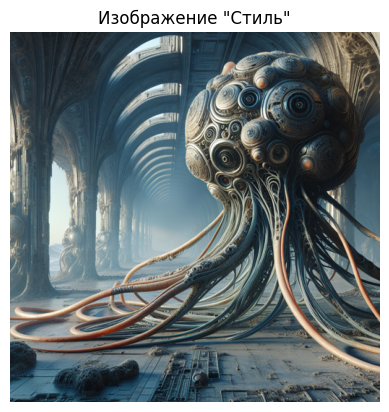

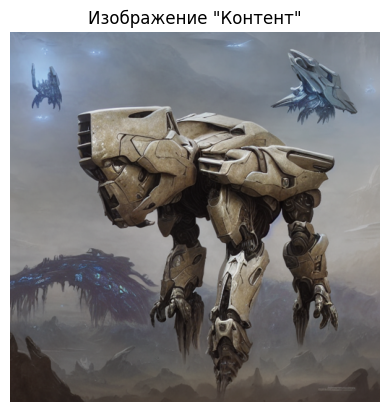

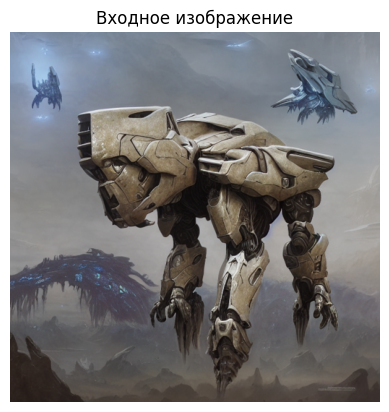

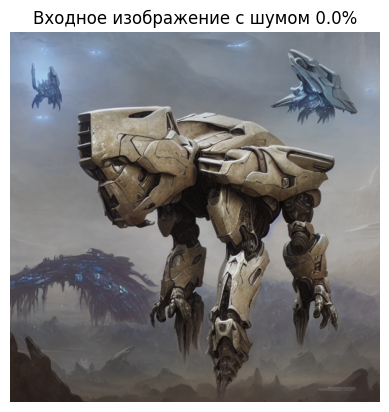

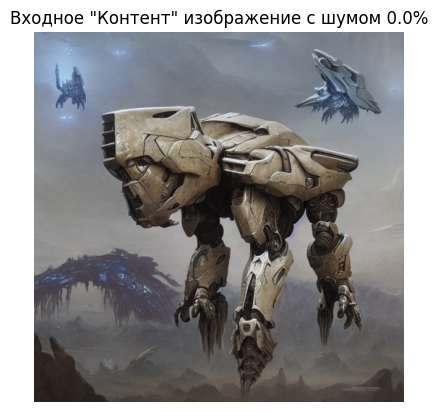

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 124.936470 Content Loss: 155.169220


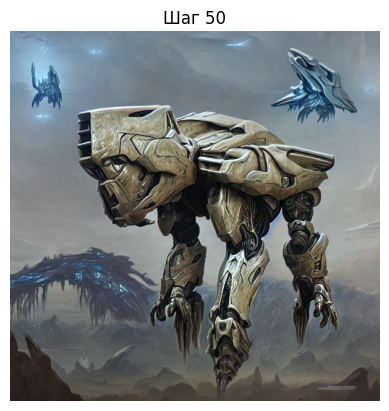


run [100]:
Style Loss : 117.425926 Content Loss: 152.841370


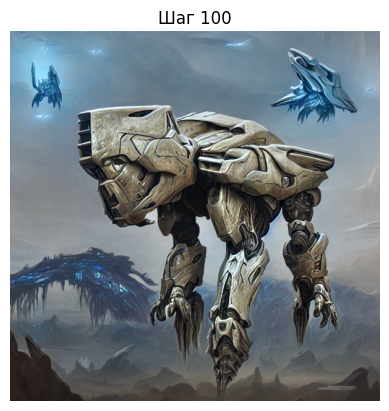


run [150]:
Style Loss : 120.625175 Content Loss: 164.703552


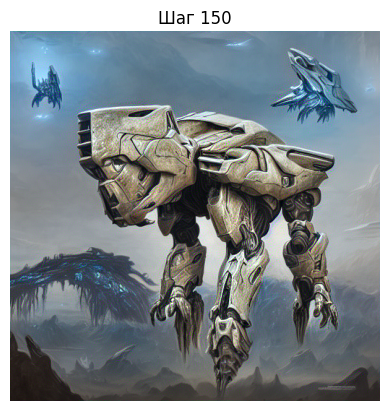


run [200]:
Style Loss : 118.001884 Content Loss: 162.831497


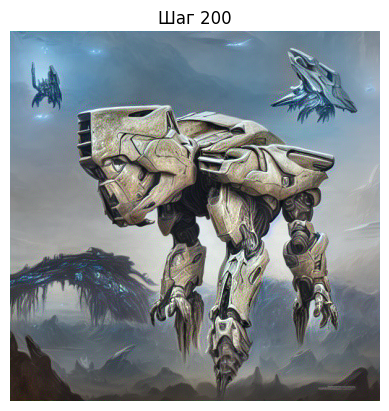


run [250]:
Style Loss : 133.423630 Content Loss: 239.955429


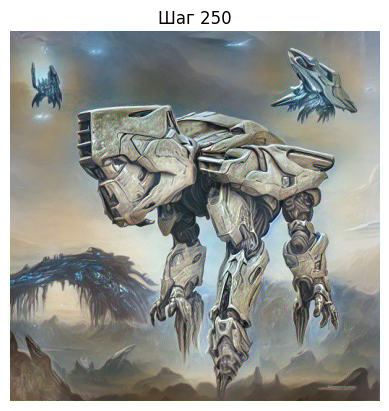


run [300]:
Style Loss : 2072411.000000 Content Loss: 44340.796875


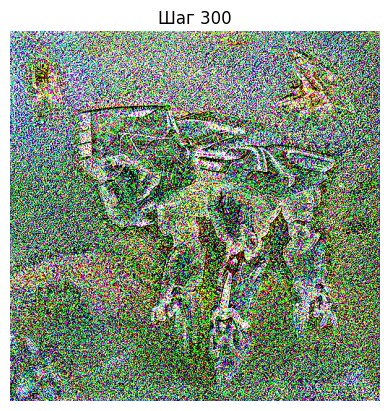

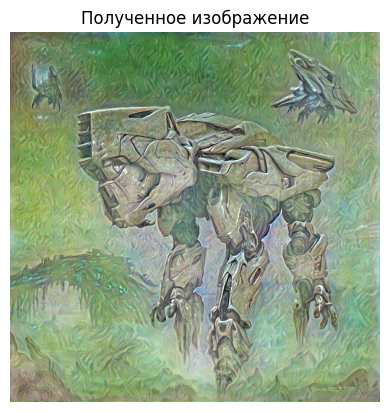

Изображение обработано.
Начало запуска обработки изображения.

full step002

path_style_img = './data/images/backdark.png'
path_content_img = './data/result/(future_robot)_to_(backdark)_result001.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



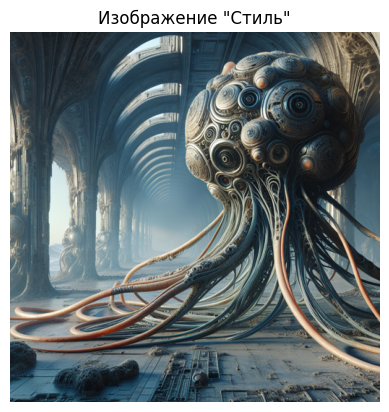

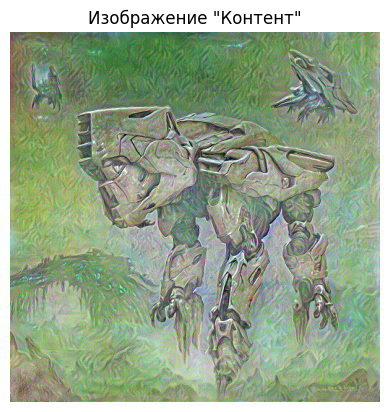

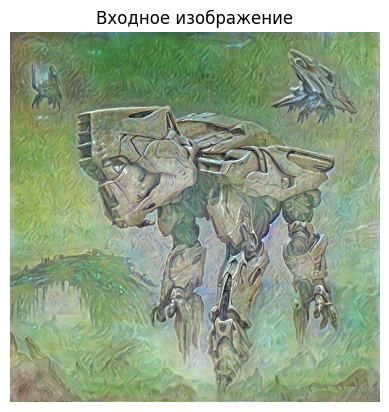

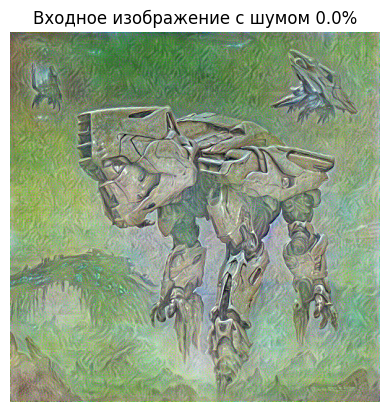

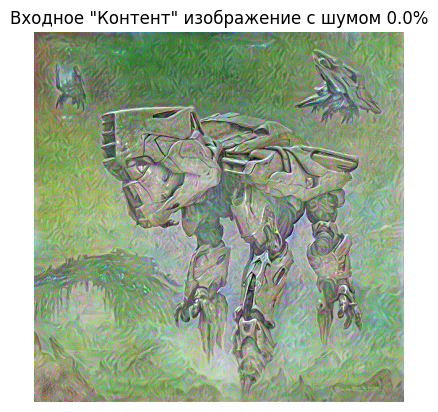

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 90.191719 Content Loss: 63.029999


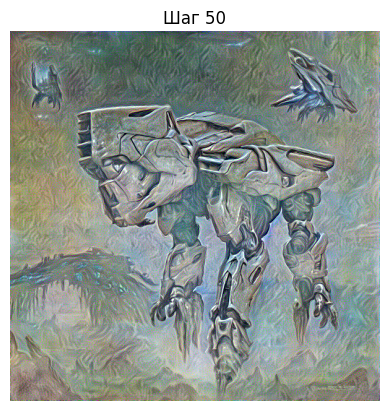


run [100]:
Style Loss : 86.965042 Content Loss: 69.769928


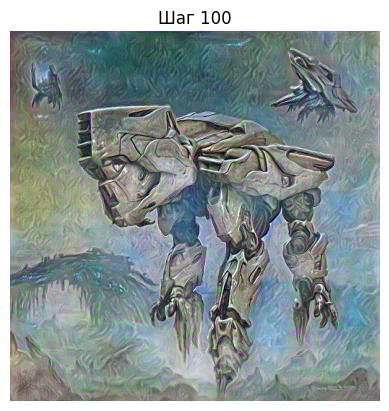


run [150]:
Style Loss : 87.697548 Content Loss: 70.355515


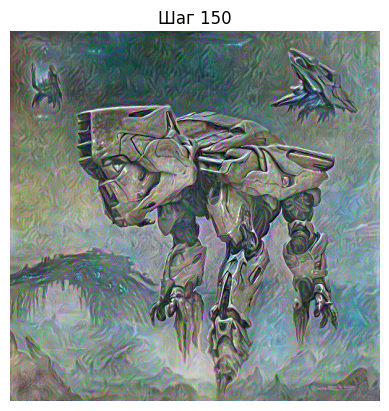


run [200]:
Style Loss : 4263.429688 Content Loss: 2651.530518


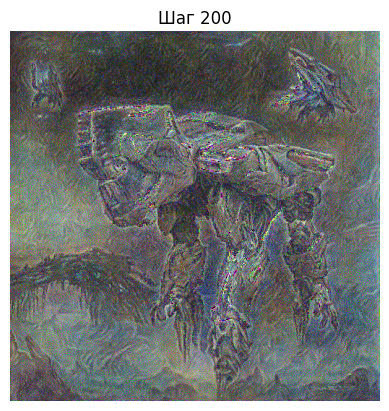


run [250]:
Style Loss : 1826705.375000 Content Loss: 40155.023438


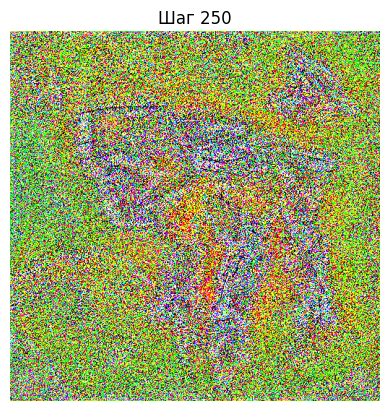


run [300]:
Style Loss : 117.075096 Content Loss: 137.330704


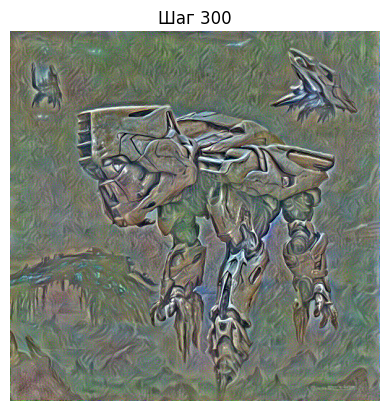

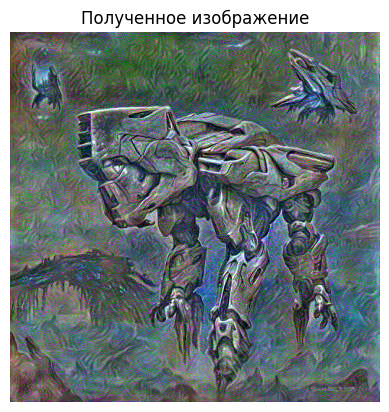

Изображение обработано.
Начало запуска обработки изображения.

full step003

path_style_img = './data/images/future_soldier.png'
path_content_img = './data/result/((future_robot)_to_(backdark)_result001)_to_(backdark)_result002.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



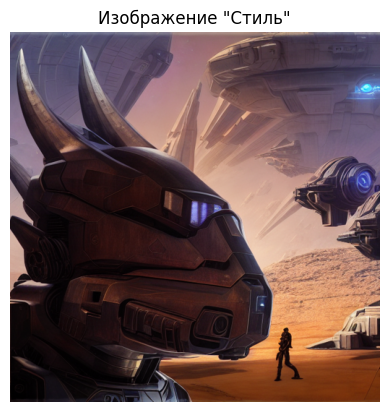

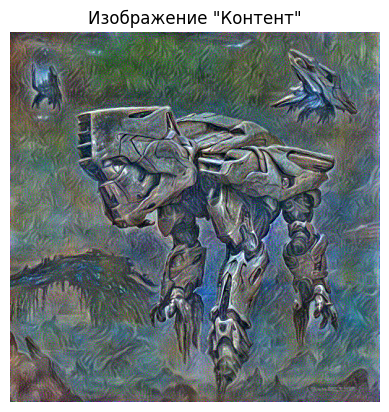

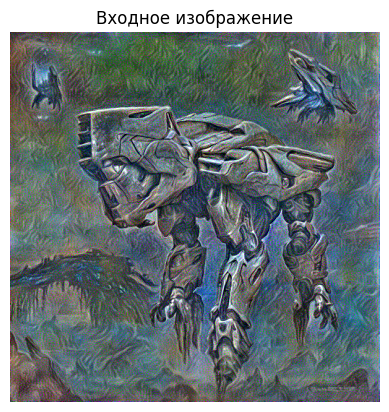

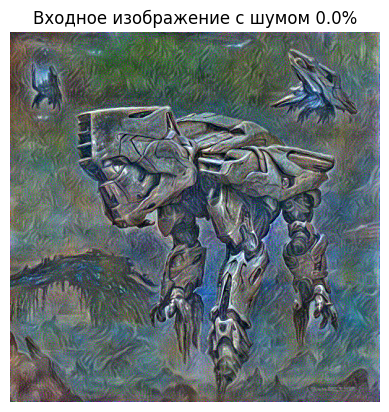

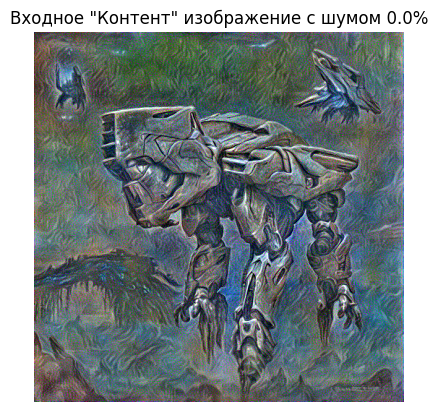

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 115.637505 Content Loss: 133.353500


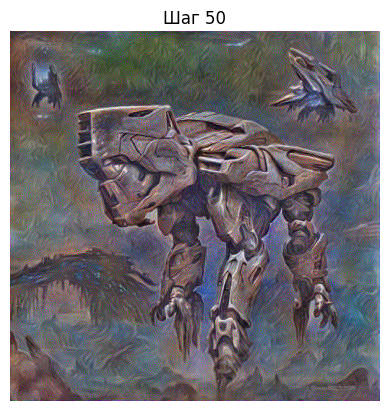


run [100]:
Style Loss : 107.352760 Content Loss: 131.867401


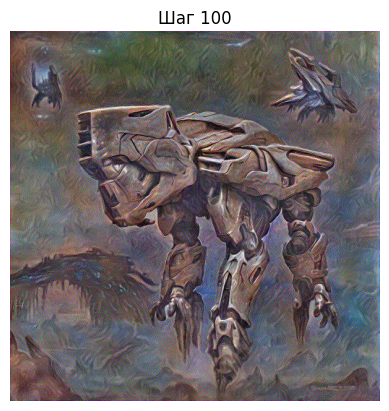


run [150]:
Style Loss : 104.415535 Content Loss: 130.565140


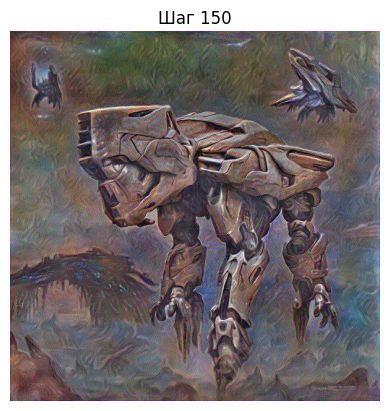


run [200]:
Style Loss : 102.477394 Content Loss: 129.398468


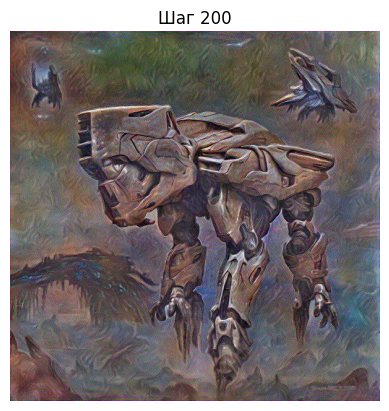


run [250]:
Style Loss : 100.932907 Content Loss: 128.558823


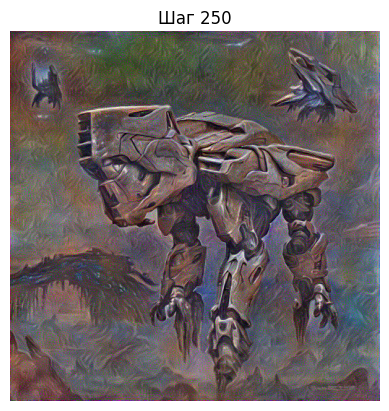


run [300]:
Style Loss : 99.689819 Content Loss: 127.869057


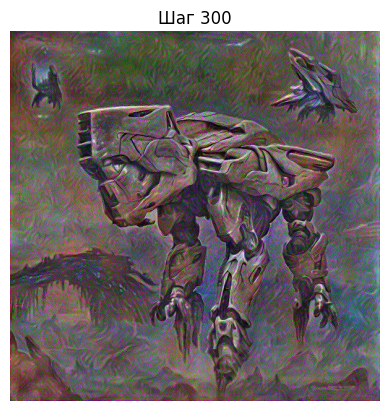

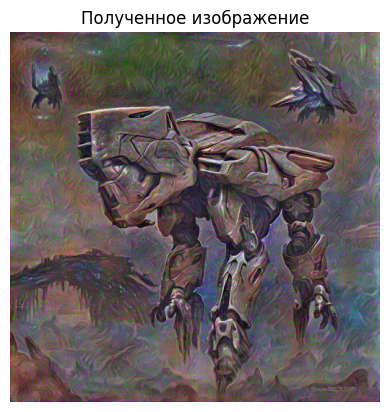

Изображение обработано.
Начало запуска обработки изображения.

full step004

path_style_img = './data/result/(((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003.png'
path_content_img = './data/images/future_soldier.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



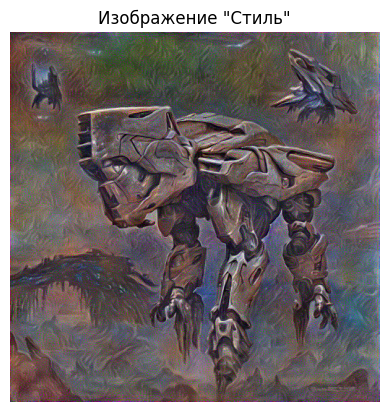

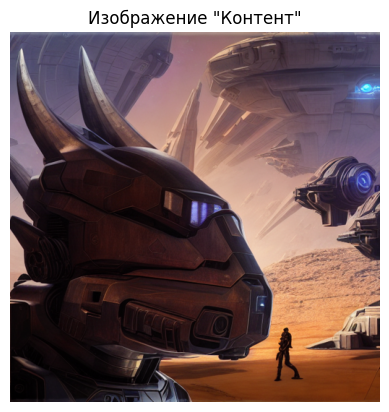

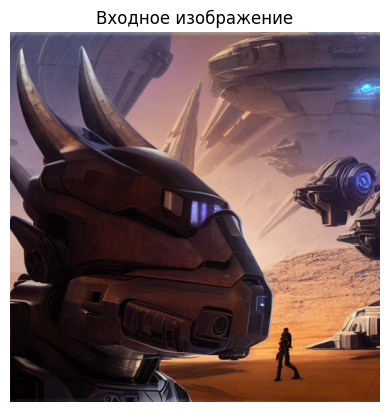

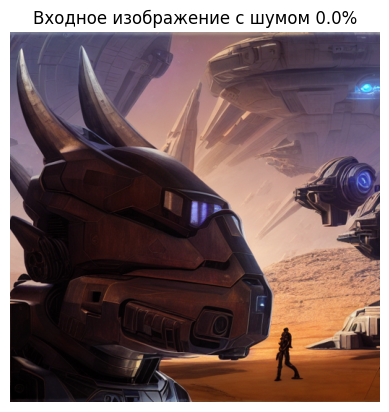

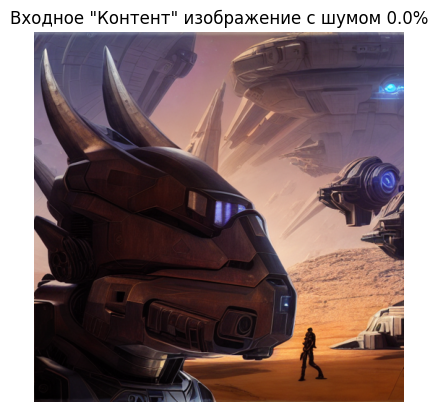

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 43.563572 Content Loss: 19.507206


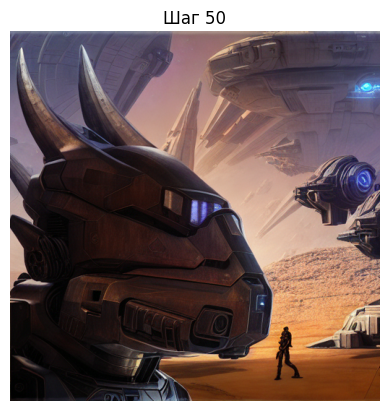


run [100]:
Style Loss : 40.144588 Content Loss: 20.103231


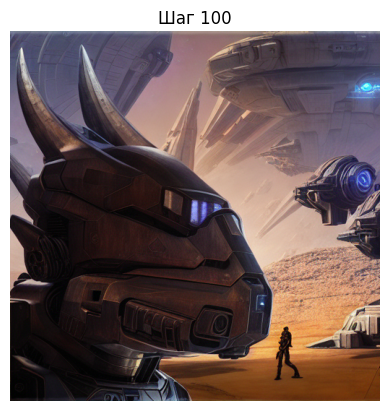


run [150]:
Style Loss : 38.541626 Content Loss: 20.413218


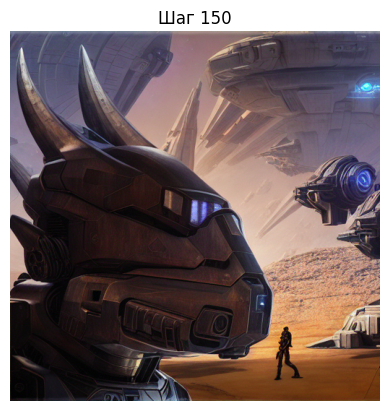


run [200]:
Style Loss : 37.748955 Content Loss: 20.491629


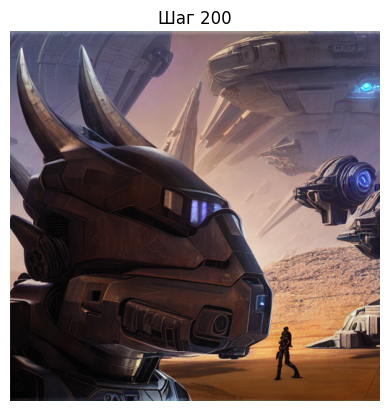


run [250]:
Style Loss : 37.257496 Content Loss: 20.530861


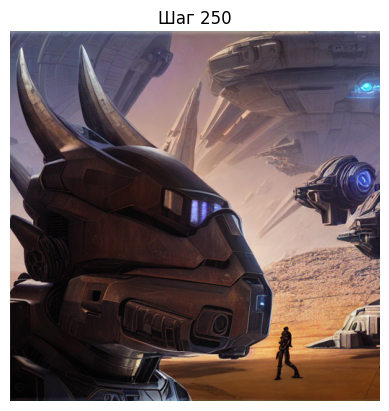


run [300]:
Style Loss : 36.906918 Content Loss: 20.548517


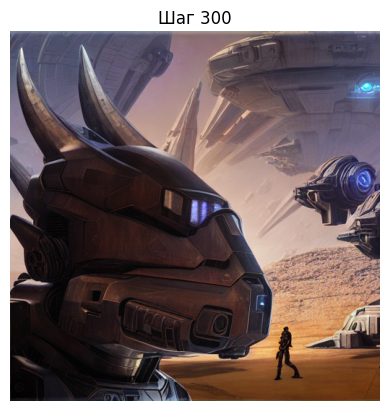

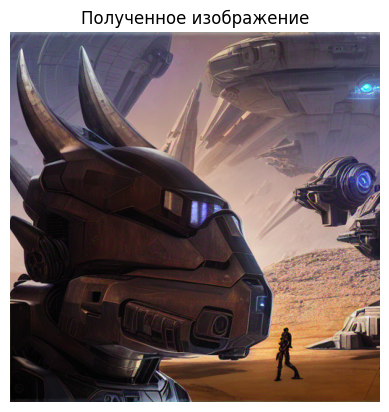

Изображение обработано.
Начало запуска обработки изображения.

full step005

path_style_img = './data/result/(((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003.png'
path_content_img = './data/result/(future_soldier)_to_((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_result004.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



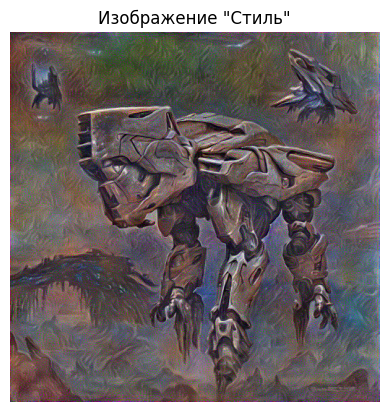

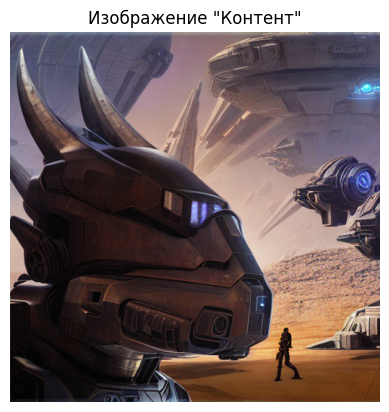

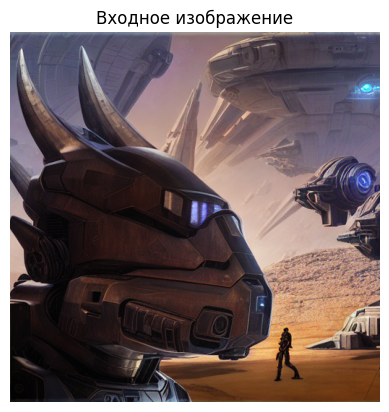

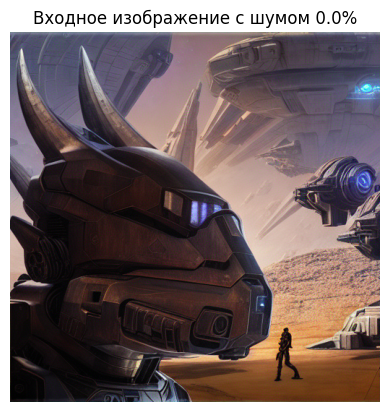

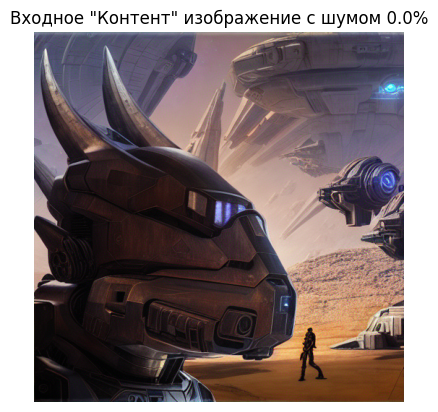

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 22.603321 Content Loss: 5.272280


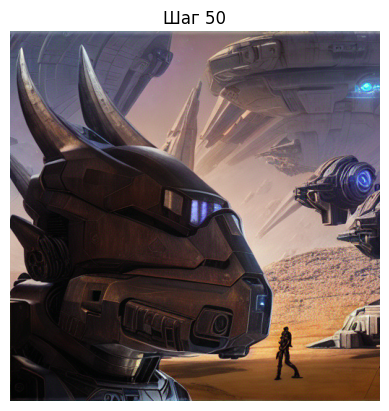


run [100]:
Style Loss : 21.536846 Content Loss: 5.676443


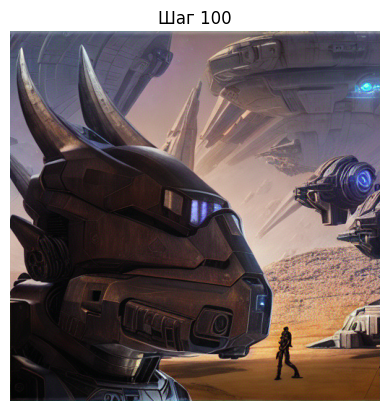


run [150]:
Style Loss : 21.012388 Content Loss: 5.892094


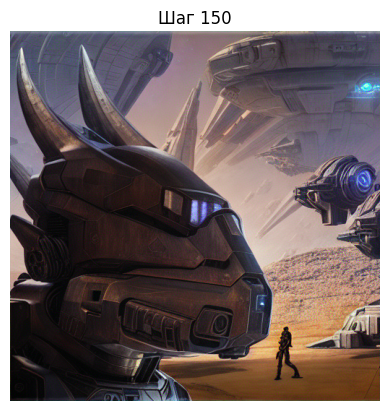


run [200]:
Style Loss : 20.623892 Content Loss: 6.164272


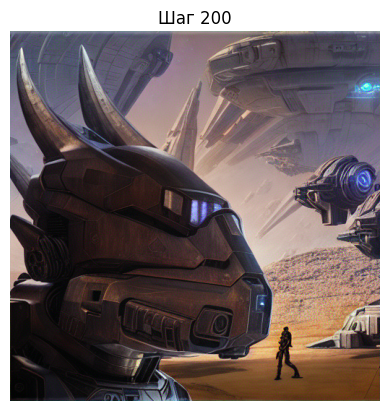


run [250]:
Style Loss : 20.441916 Content Loss: 6.196246


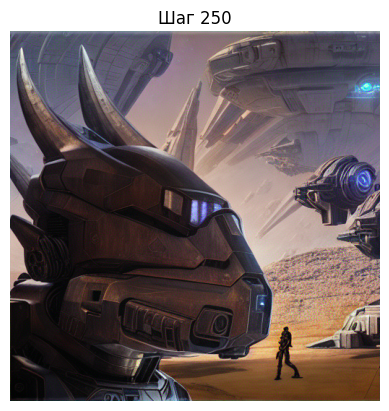


run [300]:
Style Loss : 20.285297 Content Loss: 6.273026


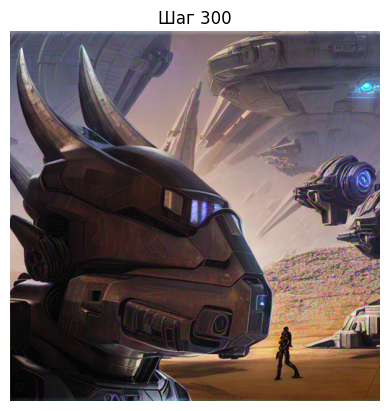

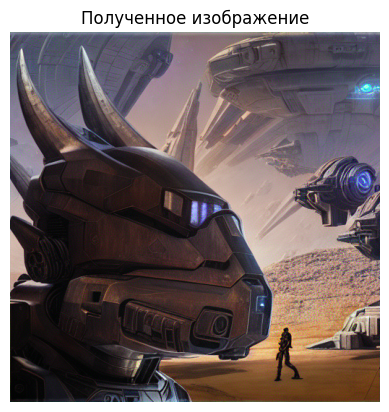

Изображение обработано.
Начало запуска обработки изображения.

full step006

path_style_img = './data/result/((future_soldier)_to_((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_result004)_to_((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_result005.png'
path_content_img = './data/result/(((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003.png'
path_steps_img = './data/steps'
path_result_img = './data/result'



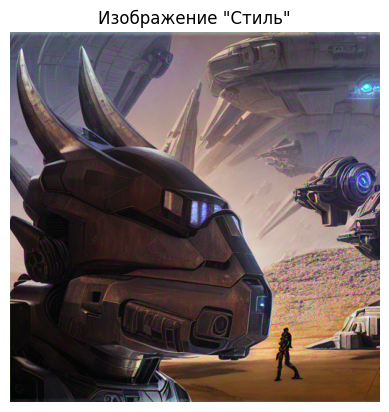

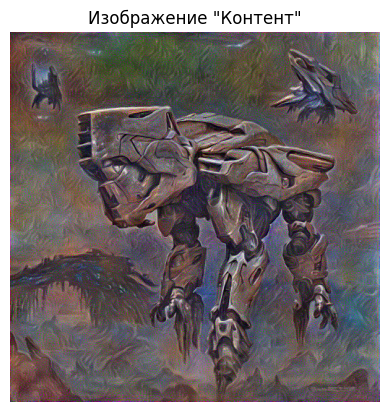

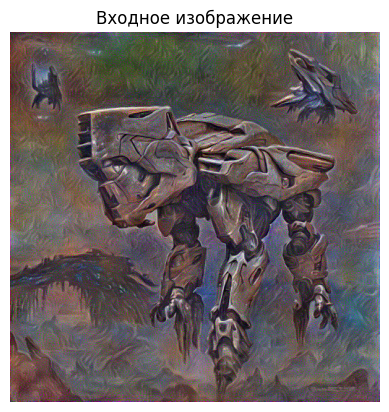

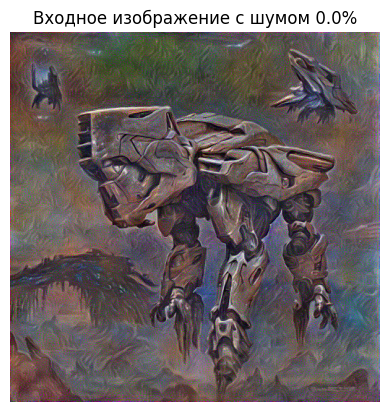

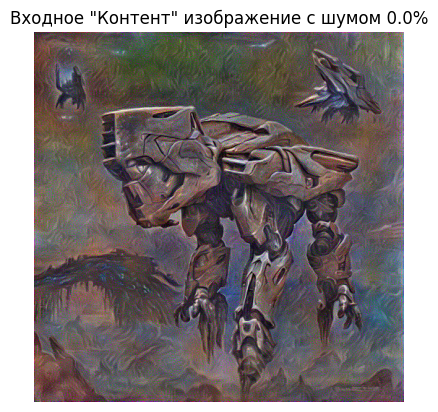

Построение модели переноса стиля..
Оптимизируем картинку..
run [50]:
Style Loss : 14.396675 Content Loss: 2.336247


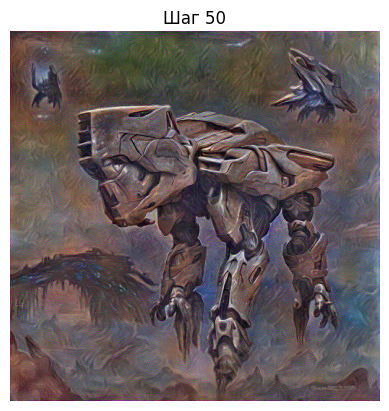

OSError: [Errno 22] Invalid argument: 'E:\\PycharmProjects\\GB\\Transfer_learning_seminar\\Lesson 2_Representation_learning\\data\\steps\\((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_to_(((future_soldier)_to_((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_result004)_to_((((future_robot)_to_(backdark)_result001)_to_(backdark)_result002)_to_(future_soldier)_result003)_result005)_step006_50.png'

In [639]:
path_style_img = "./data/images/backdark.png"
path_content_img = "./data/images/future_robot.png"
path_steps_img = "./data/steps"
path_result_img = "./data/result"

noise_img = 0.00
number_out = 1


num_steps_in = 300
style_weight_in = 1000
content_weight_in= 5

width_height = 512

for i in range(6):
    if i == 1:
        style_weight_in *= 50
    if i == 2:
        path_style_img = "./data/images/future_soldier.png"
    if i == 3:
        path_style_img, path_content_img = path_content_img, path_style_img
    if i == 4:
        style_weight_in *= 200
    if i == 5:
        path_style_img, path_content_img = path_content_img, path_style_img

    
    # https://ru.stackoverflow.com/questions/628701/Вывод-числа-с-ведущими-нолями
    number_out_str = f'{number_out:03}'
    print("Начало запуска обработки изображения.")
    print()
    print(f"full step{number_out_str}")
    print()
    print(f"{path_style_img = }")
    print(f"{path_content_img = }")
    print(f"{path_steps_img = }")
    print(f"{path_result_img = }")
    print()
    
    run_init()
    print("Изображение обработано.")
    number_out += 1



## Библиография

[Image Stylization: History and Future (Part 1)](https://research.adobe.com/news/image-stylization-history-and-future/), Adobe Research 2018

[Intro | Neural Style Transfer #1](https://www.youtube.com/watch?v=S78LQebx6jo), [Basic Theory | Neural Style Transfer #2](https://www.youtube.com/watch?v=B22nIUhXo4E&t=199s)...

[Neural Transfer Using PyTorch](https://pytorch.org/tutorials/advanced/neural_style_tutorial.html)

NST на tensorflow: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/style_transfer.ipynb

[Visualizing Feature Maps using PyTorch](https://ravivaishnav20.medium.com/visualizing-feature-maps-using-pytorch-12a48cd1e573)